In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!unzip data.zip
!unzip model.zip
!unzip util.zip

Streaming output truncated to the last 5000 lines.
  inflating: data/downSampledImages/0__20161022_180612_0e19__-122.05294087231242_37.69715889815695_downSampled.png  
  inflating: data/downSampledImages/0__20161022_180612_0e19__-122.16267462602649_37.6708146046706_downSampled.png  
  inflating: data/downSampledImages/0__20161102_180658_0e26__-122.38146324377499_37.79495145620145_downSampled.png  
  inflating: data/downSampledImages/0__20161102_180659_0e26__-122.36166526983595_37.719730414156764_downSampled.png  
  inflating: data/downSampledImages/0__20161102_202001_0c75__-122.33669212065975_37.756528435140176_downSampled.png  
  inflating: data/downSampledImages/0__20161102_202002_0c75__-122.17804250675646_37.75471754640761_downSampled.png  
  inflating: data/downSampledImages/0__20161103_195402_1_0c24__-122.16304622327651_37.8674721477702_downSampled.png  
  inflating: data/downSampledImages/0__20161103_195522_0c27__-122.47202178027077_37.748667907390434_downSampled.png  
  inflatin

In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import torch
import utils
import skimage.color as sc
import cv2
import os
import pandas as pd
import skimage.measure    
from data.CustomDataset import imageDataset
from torch.utils.data import DataLoader
from torchvision import transforms as T
from model import esrt

/home/rts3012/anaconda3/lib/python3.11/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: 'libc10_cuda.so: cannot open shared object file: No such file or directory'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


In [5]:
!unzip SavedModels.zip

Archive:  SavedModels.zip
   creating: SavedModels/
   creating: SavedModels/2x/
   creating: SavedModels/2x/10_Jun/
  inflating: SavedModels/2x/10_Jun/epoch_90.pth  
  inflating: SavedModels/2x/10_Jun/epoch_100.pth  
  inflating: SavedModels/2x/10_Jun/unseen_annotations_ESRT_x2.csv  
   creating: SavedModels/4x/
   creating: SavedModels/4x/10_Jun/
  inflating: SavedModels/4x/10_Jun/epoch_100.pth  
  inflating: SavedModels/4x/10_Jun/unseen_annotations_ESRT_x4.csv  


In [13]:
#Parameters
ANNOTATIONS = 'data/metadata/test.csv'
GT_DIRECTORY = 'data/shipsDataset/shipsnet/shipsnet/'
LEARNING_RATE = 2e-4
SCALE = 4
STEP_SIZE = 200
GAMMA = 0.5
TEST_BATCH_SIZE = 1
PATCH_SIZE = 12
isY = True
N_COLOURS = 3
RGB_RANGE = 1
DATE = "17_Jun"
MODEL = "Vanilla_ESRT"
OUTPUT_FOLDER = "Test_Outputs/{}/{}/{}x/".format(MODEL, DATE, SCALE)
MODEL_DICT = 'SavedModels/{}/{}/{}x/epoch_100.pth'.format(MODEL, DATE ,SCALE)

#Change directory depending on 2x vs 4x
if(SCALE == 2):
    DOWNSAMPLED_DIR = 'data/downSampledImages/'
else:
    DOWNSAMPLED_DIR = 'data/downSampledImages025/'

In [5]:
gt_list = [] #create list of gt image names
annotations = pd.read_csv(ANNOTATIONS)
for i in range(len(annotations)):
    gt = annotations.iloc[i][0]
    gt_list.append(gt)

/tmp/ipykernel_9007/1812900703.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  gt = annotations.iloc[i][0]


In [6]:
transform = T.Compose([ #transforms to be used when iterating images
    T.ToTensor()
])

In [7]:
#check if gpu available
if torch.cuda.is_available():
        device = "cuda"
else:
        device = "cpu"
print(f"using {device}")

using cpu


In [14]:
#Load model
model =  esrt.ESRT(upscale = SCALE)
model_dict = utils.load_state_dict(MODEL_DICT, torch.cuda.is_available())
model.load_state_dict(model_dict, strict=False)#True)

scale 0.16666666666666666
288
36


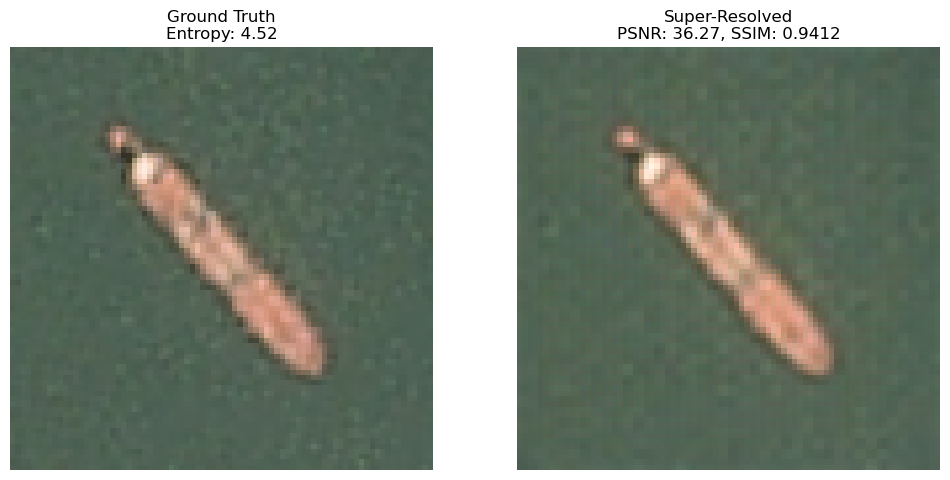

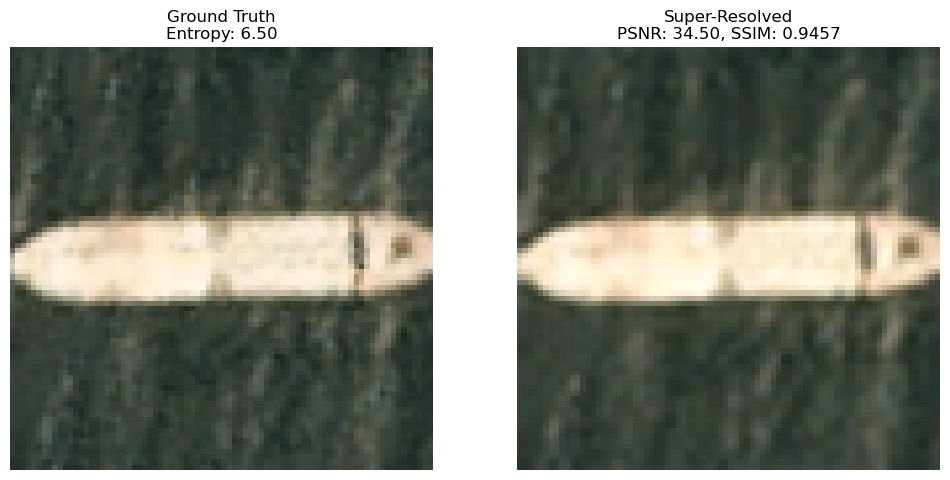

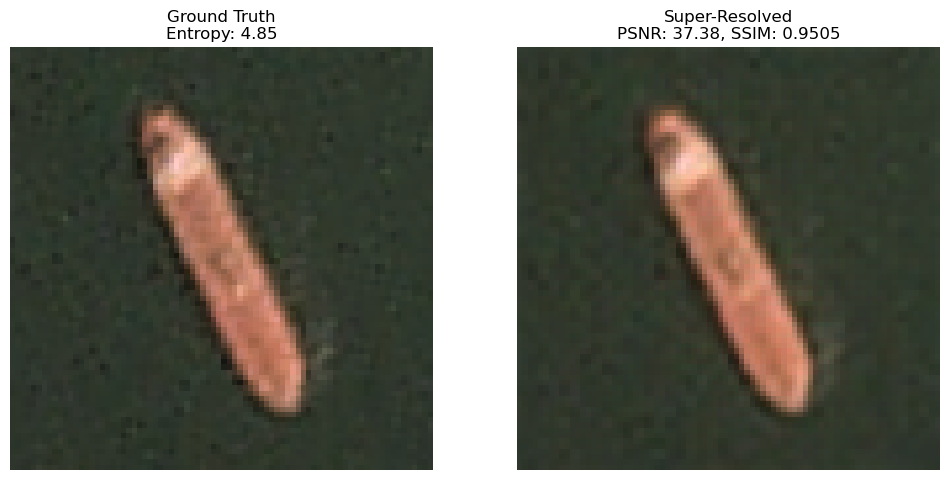

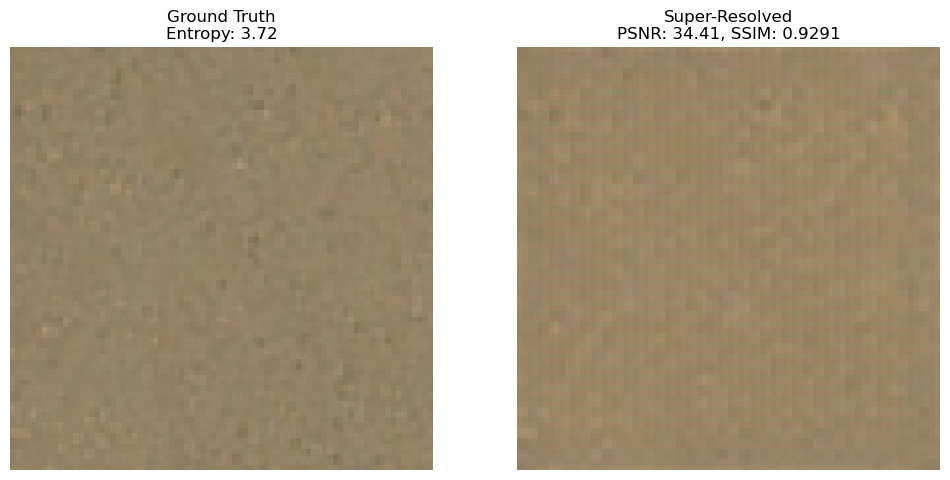

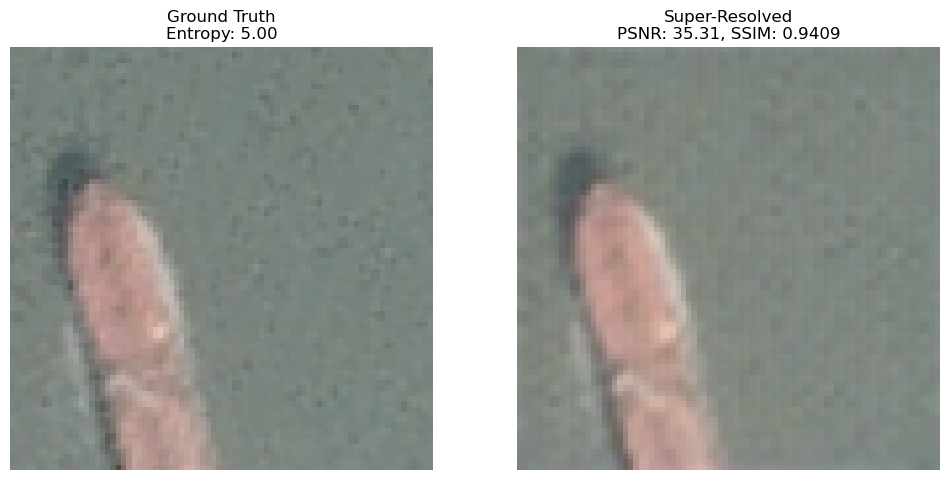

...

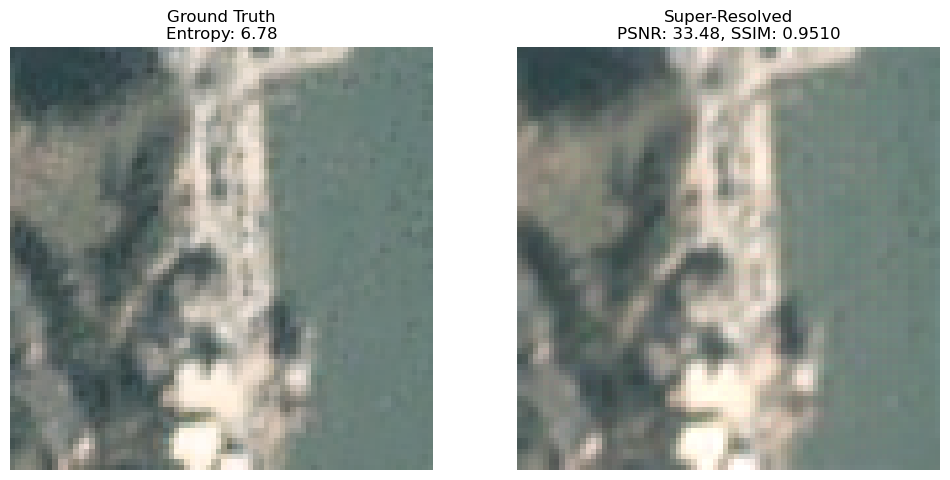

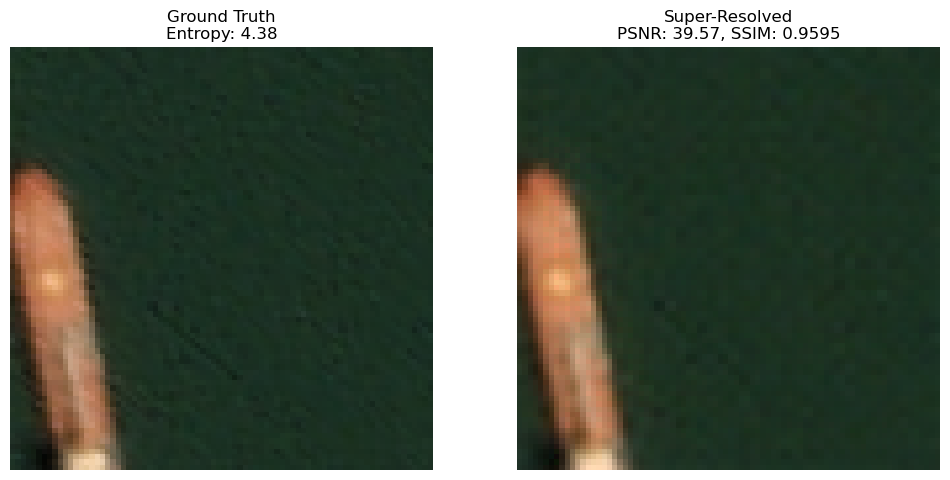

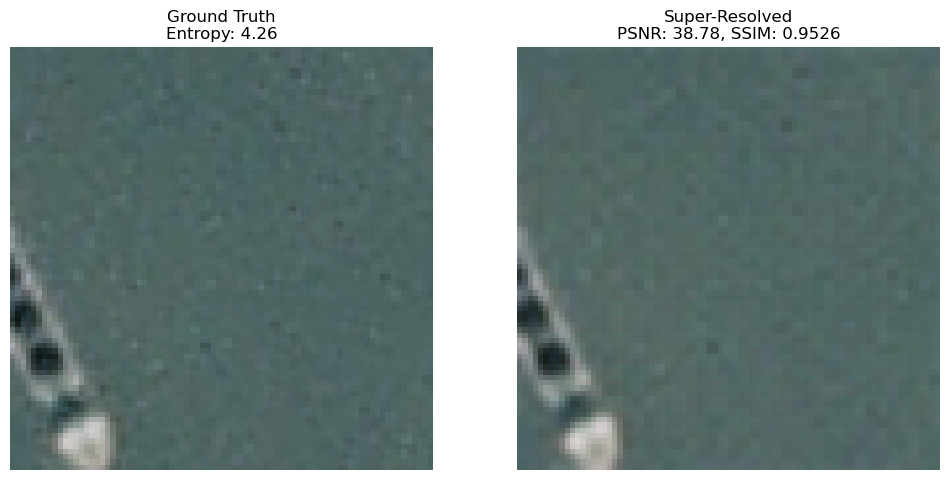

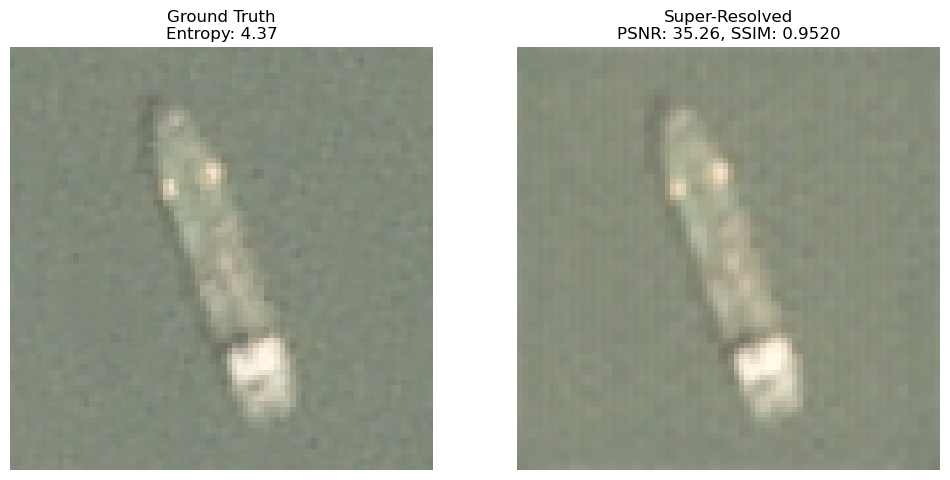

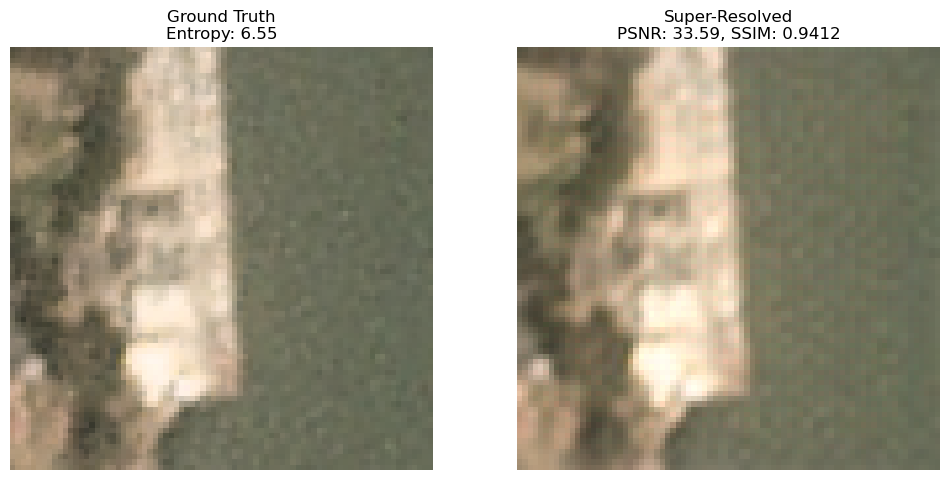

===> Valid. psnr: 35.7784, ssim: 0.9433


In [11]:
avg_psnr, avg_ssim = 0, 0
entropies = []
ssims = []
psnrs = []
#Testing Loop
for imname in gt_list:
    gray_gt_image = cv2.imread(GT_DIRECTORY + imname)
    gray_gt_image = cv2.cvtColor(gray_gt_image, cv2.COLOR_BGR2GRAY) #get gray gt image
    gt_entropy = skimage.measure.shannon_entropy(gray_gt_image) #measure entropy of gt
    entropies.append(gt_entropy) #append entropy to 
    im_gt = cv2.imread(GT_DIRECTORY + imname, cv2.IMREAD_COLOR)[:, :, [2, 1, 0]]  # BGR to RGB
    im_gt = utils.modcrop(im_gt, 2)
    if(SCALE == 2): #read different low res image depending on scale
        im_l = cv2.imread(DOWNSAMPLED_DIR + imname.replace('.png', '_downSampled.png'), cv2.IMREAD_COLOR)[:, :, [2, 1, 0]]  # BGR to RGB
    else:
        im_l = cv2.imread(DOWNSAMPLED_DIR + imname.replace('.png', '_downSampled025.png'), cv2.IMREAD_COLOR)[:, :, [2, 1, 0]]  # BGR to RGB
    
    #Ensuring images have 3 channels
    if len(im_gt.shape) < 3:
        im_gt = im_gt[..., np.newaxis]
        im_gt = np.concatenate([im_gt] * 3, 2)
        im_l = im_l[..., np.newaxis]
        im_l = np.concatenate([im_l] * 3, 2)
    im_input = im_l / 255.0 #normalise
    im_input = np.transpose(im_input, (2, 0, 1)) #reorder to (channels, height, width)
    im_input = im_input[np.newaxis, ...] #add batch dimension
    im_input = torch.from_numpy(im_input).float() #convert to float tensor

    #set model and input to gpu
    if torch.cuda.is_available():
      model = model.to(device)
      im_input = im_input.to(device)

    #don't calculate gradients
    with torch.no_grad():
        out = model(im_input)
    out_img = utils.tensor2np(out.detach()[0]) #remove computation graph and convert to numpy
    crop_size = SCALE
    cropped_sr_img = utils.shave(out_img, crop_size) #remove image borders
    cropped_gt_img = utils.shave(im_gt, crop_size)
    if isY is True: #Convert to YCbCr colour space
        im_label = utils.quantize(sc.rgb2ycbcr(cropped_gt_img)[:, :, 0])
        im_pre = utils.quantize(sc.rgb2ycbcr(cropped_sr_img)[:, :, 0])
    else:
        im_label = cropped_gt_img
        im_pre = cropped_sr_img
    psnr = utils.compute_psnr(im_pre, im_label) #compute psnr and ssim
    ssim = utils.compute_ssim(im_pre, im_label)
    avg_psnr += psnr
    avg_ssim += ssim

    psnrs.append(psnr)
    ssims.append(ssim)
    
    output_folder = OUTPUT_FOLDER
    if not os.path.exists(output_folder): #create output folder
        os.makedirs(output_folder)

    #save sr image to folder
    #cv2.imwrite(OUTPUT_FOLDER + imname, out_img[:, :, [2, 1, 0]])

    #plot sr and gt side-by-side
    _, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(im_gt)
    axes[0].set_title(f'Ground Truth\nEntropy: {gt_entropy:.2f}')
    axes[0].axis('off')

    axes[1].imshow(out_img)
    axes[1].set_title(f'Super-Resolved\nPSNR: {psnr:.2f}, SSIM: {ssim:.4f}')
    axes[1].axis('off')

    plt.show()
print("===> Valid. psnr: {:.4f}, ssim: {:.4f}".format(avg_psnr / len(annotations), avg_ssim / len(annotations)))

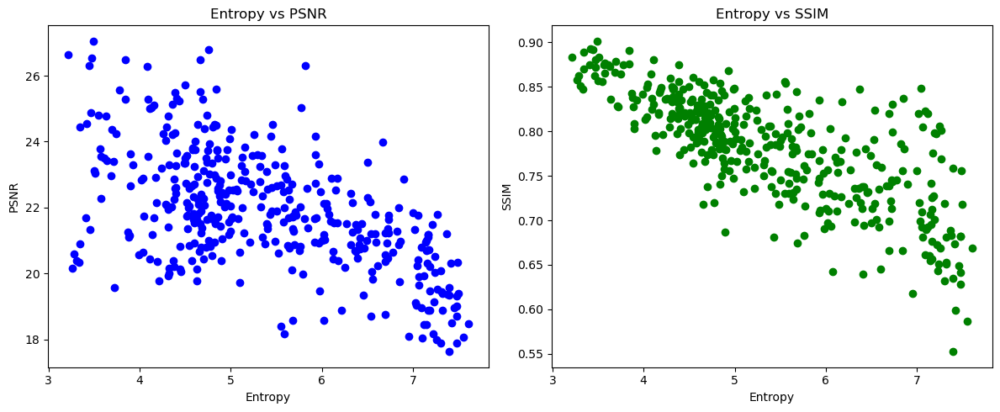

In [16]:

# Create a figure with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

# Scatter plot for Entropy vs PSNR
ax1.scatter(entropies, psnrs, color='blue')
ax1.set_title('Entropy vs PSNR')
ax1.set_xlabel('Entropy')
ax1.set_ylabel('PSNR')

# Scatter plot for Entropy vs SSIM
ax2.scatter(entropies, ssims, color='green')
ax2.set_title('Entropy vs SSIM')
ax2.set_xlabel('Entropy')
ax2.set_ylabel('SSIM')

# Display the plots
plt.tight_layout()
plt.show()
fig.savefig('Entropy.pdf')

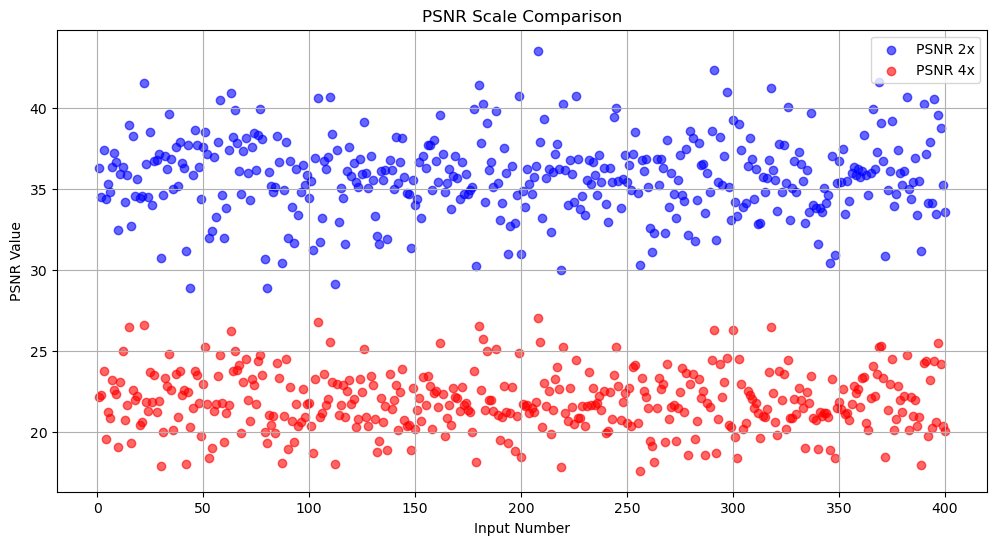

In [20]:
# Generate input numbers (1 to 400)
input_numbers = list(range(1, 401))

# Create the scatter plot
fig = plt.figure(figsize=(12, 6))

# Plot the first set of PSNR values
plt.scatter(input_numbers, psnrs, color='blue', label='PSNR 2x', alpha=0.6)

# Plot the second set of PSNR values
plt.scatter(input_numbers, psnrs025, color='red', label='PSNR 4x', alpha=0.6)

# Add labels, title, legend, and grid
plt.xlabel('Input Number')
plt.ylabel('PSNR Value')
plt.title('PSNR Scale Comparison')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()
fig.savefig('PSNRScaleComparison.pdf')


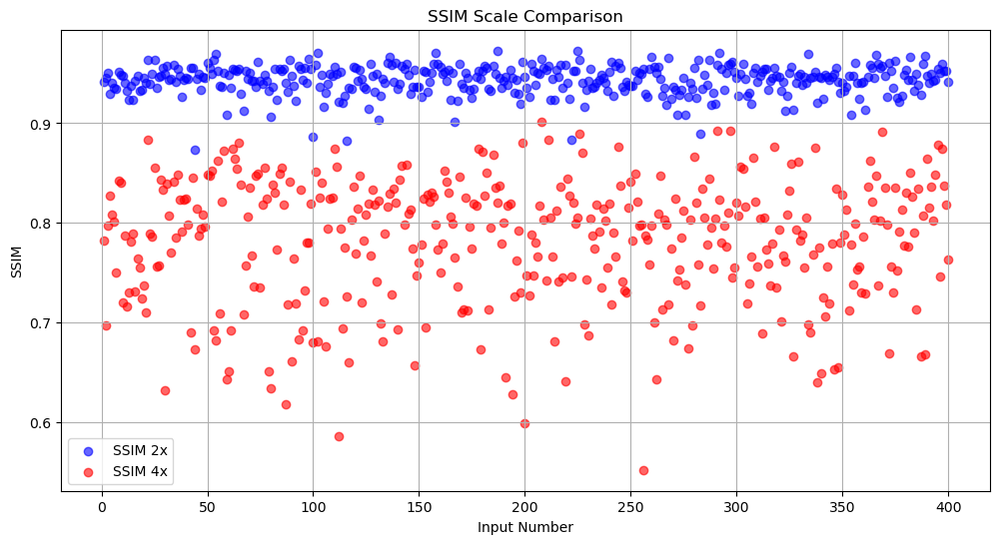

In [21]:

# Create the scatter plot
fig = plt.figure(figsize=(12, 6))

# Plot the first set of PSNR values
plt.scatter(input_numbers, ssims, color='blue', label='SSIM 2x', alpha=0.6)

# Plot the second set of PSNR values
plt.scatter(input_numbers, ssims025, color='red', label='SSIM 4x', alpha=0.6)

# Add labels, title, legend, and grid
plt.xlabel('Input Number')
plt.ylabel('SSIM')
plt.title('SSIM Scale Comparison')
plt.legend()
plt.grid(True)

# Show the plot
plt.show()
fig.savefig('SSIMScaleComparison.pdf')

In [30]:
!zip -r /content/Test_Outputs.zip /content/Test_Outputs
from google.colab import files
files.download("/content/Test_Outputs.zip")


  adding: content/Test_Outputs/ (stored 0%)
  adding: content/Test_Outputs/11_Jun/ (stored 0%)
  adding: content/Test_Outputs/11_Jun/2x/ (stored 0%)
  adding: content/Test_Outputs/11_Jun/2x/0__20170502_180546_1044__-122.18004629903031_37.70581751964811.png (stored 0%)
  adding: content/Test_Outputs/11_Jun/2x/0__20170708_180826_1021__-122.33579750385003_37.75755089227916.png (stored 0%)
  adding: content/Test_Outputs/11_Jun/2x/1__20171118_185722_0f2d__-122.33606293980446_37.7583365292858.png (stored 0%)
  adding: content/Test_Outputs/11_Jun/2x/0__20180712_211332_0f06__-118.20546661045374_33.70636261283587.png (deflated 0%)
  adding: content/Test_Outputs/11_Jun/2x/1__20180709_182127_0e20__-122.3242066077652_37.728850265219606.png (deflated 0%)
  adding: content/Test_Outputs/11_Jun/2x/1__20171213_181610_100c__-122.34241525126555_37.72170665596761.png (deflated 0%)
  adding: content/Test_Outputs/11_Jun/2x/1__20170609_180751_101b__-122.34159897445588_37.71778136707163.png (deflated 0%)
  ad

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [31]:
from google.colab import runtime
runtime.unassign()